# Assignment 1. House Pricing.

You are given a dataset of house prices.

Your goal is two fold:
1. Perform exhastive Exploratory Data Analysis (EDA)
2. Build a simple machine learning model (regression) using appropriate cross-validation procedure. Task is to predict **house price**.

This notebook will guide you through, let's start!

----

We are using house sale price data from King County, Wahington, USA. This dataset is in public domain and can be obtained from Kaggle: https://www.kaggle.com/harlfoxem/housesalesprediction

Alternatively, from here: https://github.com/dbendet/coursera_machine_learning/blob/master/kc_house_data.csv

You need to place `kc_nouse_data.csv` file in the same directory as this notebook.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

### 1. Loading data

As always in Data Science you are starting with making nice cup of tea (or coffee). Your next move is to load the data:

- Start with loading `house_data.csv` file using `pd.read_csv()` function.
- You may also want to increase maximal displayed pandas columns: set `pd.options.display.max_columns` to 30
- Print top 10 observations in the table.
- Print last 10 observations in the table.
- Print all the data columns names using method `.columns`
- Print data size (number of rows and columns)

**Hint 1** Every Python has a `head` and a `tail` just as DataFrames do.

In [2]:
# Load the data
housedata = pd.read_csv('kc_house_data.csv')

In [3]:
# Observe top 10 observations
housedata.head(10)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
5,7237550310,20140512T000000,1225000.0,4,4.50,5420,101930,1.0,0,0,...,11,3890,1530,2001,0,98053,47.6561,-122.005,4760,101930
6,1321400060,20140627T000000,257500.0,3,2.25,1715,6819,2.0,0,0,...,7,1715,0,1995,0,98003,47.3097,-122.327,2238,6819
7,2008000270,20150115T000000,291850.0,3,1.50,1060,9711,1.0,0,0,...,7,1060,0,1963,0,98198,47.4095,-122.315,1650,9711
8,2414600126,20150415T000000,229500.0,3,1.00,1780,7470,1.0,0,0,...,7,1050,730,1960,0,98146,47.5123,-122.337,1780,8113
9,3793500160,20150312T000000,323000.0,3,2.50,1890,6560,2.0,0,0,...,7,1890,0,2003,0,98038,47.3684,-122.031,2390,7570


In [4]:
# Observe last 10 observations
housedata.tail(10)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
21603,7852140040,20140825T000000,507250.0,3,2.50,2270,5536,2.0,0,0,...,8,2270,0,2003,0,98065,47.5389,-121.881,2270,5731
21604,9834201367,20150126T000000,429000.0,3,2.00,1490,1126,3.0,0,0,...,8,1490,0,2014,0,98144,47.5699,-122.288,1400,1230
21605,3448900210,20141014T000000,610685.0,4,2.50,2520,6023,2.0,0,0,...,9,2520,0,2014,0,98056,47.5137,-122.167,2520,6023
21606,7936000429,20150326T000000,1007500.0,4,3.50,3510,7200,2.0,0,0,...,9,2600,910,2009,0,98136,47.5537,-122.398,2050,6200
21607,2997800021,20150219T000000,475000.0,3,2.50,1310,1294,2.0,0,0,...,8,1180,130,2008,0,98116,47.5773,-122.409,1330,1265
21608,263000018,20140521T000000,360000.0,3,2.50,1530,1131,3.0,0,0,...,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,20150223T000000,400000.0,4,2.50,2310,5813,2.0,0,0,...,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,20140623T000000,402101.0,2,0.75,1020,1350,2.0,0,0,...,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,20150116T000000,400000.0,3,2.50,1600,2388,2.0,0,0,...,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287
21612,1523300157,20141015T000000,325000.0,2,0.75,1020,1076,2.0,0,0,...,7,1020,0,2008,0,98144,47.5941,-122.299,1020,1357


In [5]:
# Increase maximal displayed columns
pd.options.display.max_columns = 30

In [6]:
# Observe top 10 observations again
housedata.head(10)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
5,7237550310,20140512T000000,1225000.0,4,4.50,5420,101930,1.0,0,0,3,11,3890,1530,2001,0,98053,47.6561,-122.005,4760,101930
6,1321400060,20140627T000000,257500.0,3,2.25,1715,6819,2.0,0,0,3,7,1715,0,1995,0,98003,47.3097,-122.327,2238,6819
7,2008000270,20150115T000000,291850.0,3,1.50,1060,9711,1.0,0,0,3,7,1060,0,1963,0,98198,47.4095,-122.315,1650,9711
8,2414600126,20150415T000000,229500.0,3,1.00,1780,7470,1.0,0,0,3,7,1050,730,1960,0,98146,47.5123,-122.337,1780,8113
9,3793500160,20150312T000000,323000.0,3,2.50,1890,6560,2.0,0,0,3,7,1890,0,2003,0,98038,47.3684,-122.031,2390,7570


In [7]:
# Print all the columns/features names
housedata.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15'],
      dtype='object')

In [8]:
# Print data size
housedata.shape

(21613, 21)

### Columns description

![title](columns_explained.png)

### 2. Simple statistics

Lets do some basics:
- Count number of not NaN's in every column.
- Is there any missing values in the data?
- Count number of unique values in every column. 
- What does this tells you about the features, which are most likely categorical and which are most likely numerical?
- Use pandas `.describe()` to display basic statistic about the data.
- Could you spot any sucpicious columns?

In [9]:
housedata.isnull().sum()
# there are no missing values

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

In [10]:
# Count number of unique values in every column
housedata.nunique()
# smaller number indicate categorical feature

id               21436
date               372
price             4028
bedrooms            13
bathrooms           30
sqft_living       1038
sqft_lot          9782
floors               6
waterfront           2
view                 5
condition            5
grade               12
sqft_above         946
sqft_basement      306
yr_built           116
yr_renovated        70
zipcode             70
lat               5034
long               752
sqft_living15      777
sqft_lot15        8689
dtype: int64

In [11]:
# Display basic data statistics
housedata.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,4.580302e+09,5.400881e+05,3.370842,2.114757,2079.899736,1.510697e+04,1.494309,0.007542,0.234303,3.409430,7.656873,1788.390691,291.509045,1971.005136,84.402258,98077.939805,47.560053,-122.213896,1986.552492,12768.455652
std,2.876566e+09,3.671272e+05,0.930062,0.770163,918.440897,4.142051e+04,0.539989,0.086517,0.766318,0.650743,1.175459,828.090978,442.575043,29.373411,401.679240,53.505026,0.138564,0.140828,685.391304,27304.179631
min,1.000102e+06,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


### 3. Not so simple statistics

You have heard that **correlation** has something to do with feature predictiveness or, not?
Any way you decided to print correlation between every column in your data:

- Create a table of pairwise correlations between columns
- What could you say about size of this table?
- Is there any missing columns? Why?
- Which features are mostly correlated with the `price`?

**Hint 1** Try out this method https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.corr.html

**Hint 2** You could actually save the result to another variable, to check its properties!

In [12]:
# Create a correlation matrix
housedata.corr()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
id,1.000000,-0.016762,0.001286,0.005160,-0.012258,-0.132109,0.018525,-0.002721,0.011592,-0.023783,0.008130,-0.010842,-0.005151,0.021380,-0.016907,-0.008224,-0.001891,0.020799,-0.002901,-0.138798
price,-0.016762,1.000000,0.308350,0.525138,0.702035,0.089661,0.256794,0.266369,0.397293,0.036362,0.667434,0.605567,0.323816,0.054012,0.126434,-0.053203,0.307003,0.021626,0.585379,0.082447
bedrooms,0.001286,0.308350,1.000000,0.515884,0.576671,0.031703,0.175429,-0.006582,0.079532,0.028472,0.356967,0.477600,0.303093,0.154178,0.018841,-0.152668,-0.008931,0.129473,0.391638,0.029244
bathrooms,0.005160,0.525138,0.515884,1.000000,0.754665,0.087740,0.500653,0.063744,0.187737,-0.124982,0.664983,0.685342,0.283770,0.506019,0.050739,-0.203866,0.024573,0.223042,0.568634,0.087175
sqft_living,-0.012258,0.702035,0.576671,0.754665,1.000000,0.172826,0.353949,0.103818,0.284611,-0.058753,0.762704,0.876597,0.435043,0.318049,0.055363,-0.199430,0.052529,0.240223,0.756420,0.183286
sqft_lot,-0.132109,0.089661,0.031703,0.087740,0.172826,1.000000,-0.005201,0.021604,0.074710,-0.008958,0.113621,0.183512,0.015286,0.053080,0.007644,-0.129574,-0.085683,0.229521,0.144608,0.718557
floors,0.018525,0.256794,0.175429,0.500653,0.353949,-0.005201,1.000000,0.023698,0.029444,-0.263768,0.458183,0.523885,-0.245705,0.489319,0.006338,-0.059121,0.049614,0.125419,0.279885,-0.011269
waterfront,-0.002721,0.266369,-0.006582,0.063744,0.103818,0.021604,0.023698,1.000000,0.401857,0.016653,0.082775,0.072075,0.080588,-0.026161,0.092885,0.030285,-0.014274,-0.041910,0.086463,0.030703
view,0.011592,0.397293,0.079532,0.187737,0.284611,0.074710,0.029444,0.401857,1.000000,0.045990,0.251321,0.167649,0.276947,-0.053440,0.103917,0.084827,0.006157,-0.078400,0.280439,0.072575
condition,-0.023783,0.036362,0.028472,-0.124982,-0.058753,-0.008958,-0.263768,0.016653,0.045990,1.000000,-0.144674,-0.158214,0.174105,-0.361417,-0.060618,0.003026,-0.014941,-0.106500,-0.092824,-0.003406


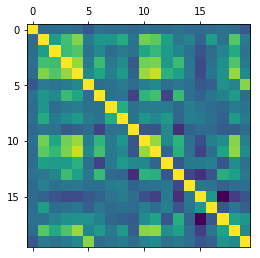

In [13]:
plt.matshow(housedata.corr())
plt.show()

In [14]:
# Print its size
housedata.corr().shape

(20, 20)

In [15]:
# Print its columns
set(housedata.corr().columns.values)

{'bathrooms',
 'bedrooms',
 'condition',
 'floors',
 'grade',
 'id',
 'lat',
 'long',
 'price',
 'sqft_above',
 'sqft_basement',
 'sqft_living',
 'sqft_living15',
 'sqft_lot',
 'sqft_lot15',
 'view',
 'waterfront',
 'yr_built',
 'yr_renovated',
 'zipcode'}

In [16]:
# Print columns of the original data, what's missing, why?
set(housedata.columns.values)

{'bathrooms',
 'bedrooms',
 'condition',
 'date',
 'floors',
 'grade',
 'id',
 'lat',
 'long',
 'price',
 'sqft_above',
 'sqft_basement',
 'sqft_living',
 'sqft_living15',
 'sqft_lot',
 'sqft_lot15',
 'view',
 'waterfront',
 'yr_built',
 'yr_renovated',
 'zipcode'}

In [17]:
set(housedata.columns.values).symmetric_difference(set(housedata.corr().columns.values))
#date is missing because not numerical

{'date'}

In [18]:
# Print correlation table, elaborate on price correlated features
housedata.corr()['price'].sort_values(ascending = False)

price            1.000000
sqft_living      0.702035
grade            0.667434
sqft_above       0.605567
sqft_living15    0.585379
bathrooms        0.525138
view             0.397293
sqft_basement    0.323816
bedrooms         0.308350
lat              0.307003
waterfront       0.266369
floors           0.256794
yr_renovated     0.126434
sqft_lot         0.089661
sqft_lot15       0.082447
yr_built         0.054012
condition        0.036362
long             0.021626
id              -0.016762
zipcode         -0.053203
Name: price, dtype: float64

### 4. Data cleaning

For your basic analysis you decide not to use column `zipcode`. You also decided to set column `id` as your data index:
- Drop column `zipcode`
- Set column `id` to be your data index


In [19]:
housedata_bckp = housedata

In [20]:
housedata

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
5,7237550310,20140512T000000,1225000.0,4,4.50,5420,101930,1.0,0,0,3,11,3890,1530,2001,0,98053,47.6561,-122.005,4760,101930
6,1321400060,20140627T000000,257500.0,3,2.25,1715,6819,2.0,0,0,3,7,1715,0,1995,0,98003,47.3097,-122.327,2238,6819
7,2008000270,20150115T000000,291850.0,3,1.50,1060,9711,1.0,0,0,3,7,1060,0,1963,0,98198,47.4095,-122.315,1650,9711
8,2414600126,20150415T000000,229500.0,3,1.00,1780,7470,1.0,0,0,3,7,1050,730,1960,0,98146,47.5123,-122.337,1780,8113
9,3793500160,20150312T000000,323000.0,3,2.50,1890,6560,2.0,0,0,3,7,1890,0,2003,0,98038,47.3684,-122.031,2390,7570


In [3]:
# drop column zipcode
housedata = housedata.drop(columns = 'zipcode')

In [4]:
# set data index
housedata['date_'] = pd.to_datetime(housedata['date'])
housedata = housedata.set_index(keys = 'date')

In [5]:
# Display top 10 observation from your data
housedata.head(10)

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,date_
date,,,,,,,,,,,,,,,,,,,,
20141013T000000,7129300520,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,47.5112,-122.257,1340,5650,2014-10-13
20141209T000000,6414100192,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,47.7210,-122.319,1690,7639,2014-12-09
20150225T000000,5631500400,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,47.7379,-122.233,2720,8062,2015-02-25
20141209T000000,2487200875,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,47.5208,-122.393,1360,5000,2014-12-09
20150218T000000,1954400510,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,47.6168,-122.045,1800,7503,2015-02-18
20140512T000000,7237550310,1225000.0,4,4.50,5420,101930,1.0,0,0,3,11,3890,1530,2001,0,47.6561,-122.005,4760,101930,2014-05-12
20140627T000000,1321400060,257500.0,3,2.25,1715,6819,2.0,0,0,3,7,1715,0,1995,0,47.3097,-122.327,2238,6819,2014-06-27
20150115T000000,2008000270,291850.0,3,1.50,1060,9711,1.0,0,0,3,7,1060,0,1963,0,47.4095,-122.315,1650,9711,2015-01-15
20150415T000000,2414600126,229500.0,3,1.00,1780,7470,1.0,0,0,3,7,1050,730,1960,0,47.5123,-122.337,1780,8113,2015-04-15


### 5. Basic date processing

You figure out that column `date` is to harsh for you, so you decided to convert it to plausible format:

- Use pandas method `to_datetime()` to convert the date to a good format.
- Exctract `year`, `month`, `day` and `weekday` from your new date column. Save them to separete columns.
- How many columns has your data now?
- Drop column `date`.


**Hint 1** for datetime formatted date you could extract the `year` as follow:
```
data.date.dt.year
```
**Hint 2** You could create new column in a DataFrame as follow:
```
data["new_column"] = 
```

**Offtop** Very often date could be a ridiculously rich feature, sometimes it is holidays that matters,

sometimes weekends, sometimes some special days like **black friday**. Learn how to work with date in Python!

In [5]:
# Convert date to datetime format
housedata['date'] = pd.to_datetime(housedata.date_)
housedata.dtypes

id                        int64
price                   float64
bedrooms                  int64
bathrooms               float64
sqft_living               int64
sqft_lot                  int64
floors                  float64
waterfront                int64
view                      int64
condition                 int64
grade                     int64
sqft_above                int64
sqft_basement             int64
yr_built                  int64
yr_renovated              int64
lat                     float64
long                    float64
sqft_living15             int64
sqft_lot15                int64
date_            datetime64[ns]
date             datetime64[ns]
dtype: object

In [26]:
# housedata['date']

In [6]:
# Extract and store year
housedata['year'] = housedata['date'].dt.year

In [7]:
# Extract and store month
housedata['month'] = housedata['date'].dt.month

In [8]:
# Extract and store day
housedata['Day'] = housedata['date'].dt.day

In [9]:
# Extract and store weekday
housedata['weekday'] = housedata['date'].dt.weekday

In [10]:
housedata_bckp2 = housedata

In [11]:
# Drop column date
housedata = housedata.drop(columns = 'date')

In [32]:
# Display top 10 observations
housedata.head(10)

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,date_,year,month,Day,weekday
date,,,,,,,,,,,,,,,,,,,,,,,,
20141013T000000,7129300520,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,47.5112,-122.257,1340,5650,2014-10-13,2014,10,13,0
20141209T000000,6414100192,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,47.7210,-122.319,1690,7639,2014-12-09,2014,12,9,1
20150225T000000,5631500400,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,47.7379,-122.233,2720,8062,2015-02-25,2015,2,25,2
20141209T000000,2487200875,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,47.5208,-122.393,1360,5000,2014-12-09,2014,12,9,1
20150218T000000,1954400510,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,47.6168,-122.045,1800,7503,2015-02-18,2015,2,18,2
20140512T000000,7237550310,1225000.0,4,4.50,5420,101930,1.0,0,0,3,11,3890,1530,2001,0,47.6561,-122.005,4760,101930,2014-05-12,2014,5,12,0
20140627T000000,1321400060,257500.0,3,2.25,1715,6819,2.0,0,0,3,7,1715,0,1995,0,47.3097,-122.327,2238,6819,2014-06-27,2014,6,27,4
20150115T000000,2008000270,291850.0,3,1.50,1060,9711,1.0,0,0,3,7,1060,0,1963,0,47.4095,-122.315,1650,9711,2015-01-15,2015,1,15,3
20150415T000000,2414600126,229500.0,3,1.00,1780,7470,1.0,0,0,3,7,1050,730,1960,0,47.5123,-122.337,1780,8113,2015-04-15,2015,4,15,2


# Ok, enough with boring routine, time to Draw!

### 6. Plot a histogram.

You are going to predict `price` and you already know its basic statistics (min, max, mean, std, 25%, 50%, 75% quantiles), but what about the whole distribution?

- Plot distribution histogramm of column `price`. Use `plt.hist()`
- What are 3 arrays that plt.hist() returns (aside from the actual plot)?
- Save these arrays to some variables
- Increase number of bins in your histogram up to 30-50
- What could you say about price distribution? Does it looks unimodal? Skewed to the right/left? Elaborate.

**Hint** you could rotate your xtick, check this out https://matplotlib.org/3.1.1/gallery/ticks_and_spines/ticklabels_rotation.html

(array([1.9021e+04, 2.1480e+03, 3.1600e+02, 9.0000e+01, 2.6000e+01,
        4.0000e+00, 4.0000e+00, 1.0000e+00, 1.0000e+00, 2.0000e+00]),
 array([  75000.,  837500., 1600000., 2362500., 3125000., 3887500.,
        4650000., 5412500., 6175000., 6937500., 7700000.]),
 <a list of 10 Patch objects>)

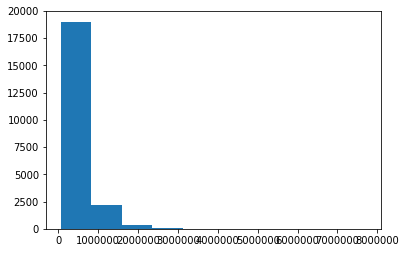

In [33]:
# Use plt.hist() to plot distribution of the price column
plt.hist(housedata['price'])
#returns bins values (hight), edges of bins (lenght) and patches list to build graph

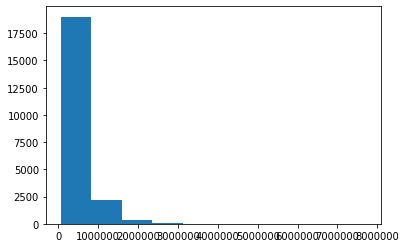

In [40]:
# Store returned arrays of plt.hist() to some variables
(bins, edges, patches) = plt.hist(housedata['price'])

(array([2.020e+02, 1.334e+03, 3.094e+03, 3.282e+03, 3.129e+03, 2.373e+03,
        2.077e+03, 1.470e+03, 1.201e+03, 8.590e+02, 6.180e+02, 4.240e+02,
        2.630e+02, 1.650e+02, 1.690e+02, 1.430e+02, 1.330e+02, 9.300e+01,
        7.900e+01, 6.100e+01, 6.400e+01, 6.200e+01, 3.700e+01, 4.100e+01,
        2.900e+01, 1.900e+01, 7.000e+00, 2.300e+01, 1.800e+01, 1.600e+01,
        1.500e+01, 1.700e+01, 1.200e+01, 5.000e+00, 8.000e+00, 4.000e+00,
        5.000e+00, 1.000e+01, 7.000e+00, 7.000e+00, 5.000e+00, 1.000e+00,
        6.000e+00, 4.000e+00, 0.000e+00, 1.000e+00, 5.000e+00, 1.000e+00,
        2.000e+00, 1.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00,
        1.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 1.000e+00, 0.000e+00,
        1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        1.000e+00, 0.000e+00, 1.000e+00, 1.000e+00, 0.000e+00, 0.000e+00,
        1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+0

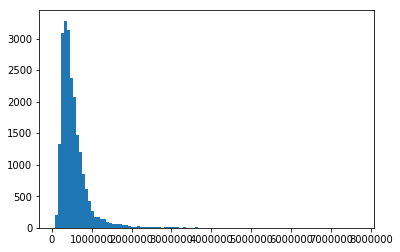

In [34]:
# Increase number of bins, plot histogram again
plt.hist(housedata['price'], bins = 100)

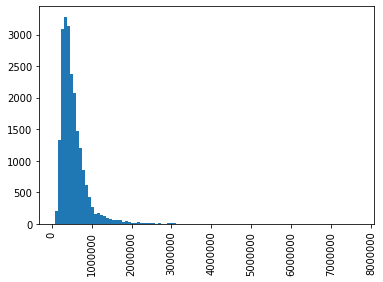

In [43]:
# Rotate xticks, plot a histogram
p = plt.hist(housedata['price'], bins = 100)
plt.xticks(rotation='vertical')
plt.show()

### 7. Customize your plot

Plot is no good without a 
- Reasonable title
- Appropriately labeled x and y axis

Add them.

**Hint** most of customization is added via `plt.` e.g. 

```
plt.title('Title')
```

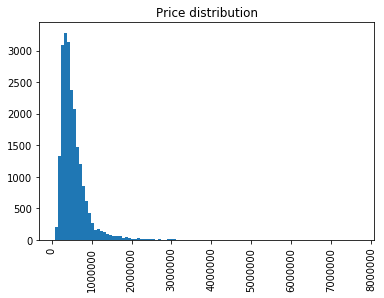

In [36]:
# add title to your histogram
p = plt.hist(housedata['price'], bins = 100)
plt.xticks(rotation='vertical')
plt.title('Price distribution')
plt.show()

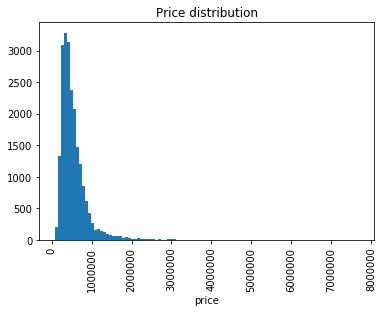

In [45]:
# Label your x axis
p = plt.hist(housedata['price'], bins = 100)
plt.xticks(rotation='vertical')
plt.title('Price distribution')
plt.xlabel('price')
plt.show()

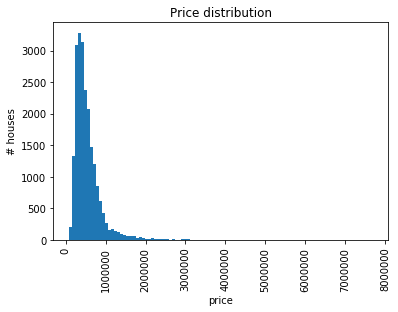

In [37]:
# Label your y axis
p = plt.hist(housedata['price'], bins = 100)
plt.xticks(rotation='vertical')
plt.title('Price distribution')
plt.xlabel('price')
plt.ylabel('# houses')
plt.show()

### 8. Plot a scatter plot

Based on a correlation table you decided to plot a scatter plot to check out dependency between price and its most correlated features.

- Choose a single most correlated with price feature.
- Plot a scatter plot (`plt.scatter()`) dependency between price and this feature.
- Label axis, add title.
- Elaborate on the picture.

**Hint** Take your correlation table and sort rows in column `price`

In [39]:
# Choose a feature
housedata.corr()['price'].sort_values(ascending = False)

price            1.000000
sqft_living      0.702035
grade            0.667434
sqft_above       0.605567
sqft_living15    0.585379
bathrooms        0.525138
view             0.397293
sqft_basement    0.323816
bedrooms         0.308350
lat              0.307003
waterfront       0.266369
floors           0.256794
yr_renovated     0.126434
sqft_lot         0.089661
sqft_lot15       0.082447
yr_built         0.054012
condition        0.036362
long             0.021626
year             0.003576
weekday         -0.001695
month           -0.010081
Day             -0.014670
id              -0.016762
Name: price, dtype: float64

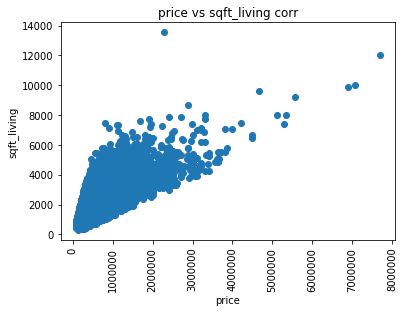

In [40]:
# Plot a scatter plot, dont forget to specify x,y label and a title
plt.scatter(housedata['price'], housedata['sqft_living'])
plt.title('price vs sqft_living corr')
plt.ylabel('sqft_living')
plt.xlabel('price')
plt.xticks(rotation='vertical')
plt.show()

### 9. More data cleaning

Based on the histogram and scatter plot you decided to remove outliers,
for the purpose of our work removing top 1% (above 99th quantile),
would be enough.

- compute 99th price quantile
- remove all observations >= 99th price quantile

**Hint** you could take a subset of a data using boolean mask, like this:

```
condition = data.col > 5
data[condition]
```

Use `numpy.quantile` to compute quantile

In [43]:
# compute price 99th quantile
np.quantile(housedata['price'], 0.99)


1964400.0000000051

In [44]:
# print number of rows in the data
housedata.shape[0]

21613

In [45]:
# compute price 99th quantile
housedata = housedata[housedata.price < np.quantile(housedata['price'], 0.99)]

In [46]:
# print number of rows in the data
housedata.shape[0]


21396

### 10. Customize scatter plot

Lets plot our scatter again, but now lets add some fancy stuff start with increasing the visual size of the plot:

- Increase figure size (check out `plt.figure()` parameters)
- Reduce size of individual scatter point to `5`
- Change color of the points to red 

**Hint 1** Check out plt.scatter() parameters

**Hint 2** You could also customize marker style, e.g. change points to triangles/squares or even small stars.

**Colors** https://matplotlib.org/2.0.2/api/colors_api.html

**Markers** https://matplotlib.org/3.1.1/api/markers_api.html

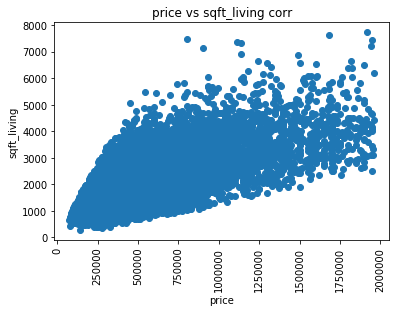

<Figure size 1080x1080 with 0 Axes>

In [47]:
# Increase figure size
# Plot a scatter plot, dont forget to specify x,y label and a title
plt.scatter(housedata['price'], housedata['sqft_living'])
plt.title('price vs sqft_living corr')
plt.ylabel('sqft_living')
plt.xlabel('price')
plt.xticks(rotation='vertical')
plt.figure(figsize = (15,15))
plt.show()

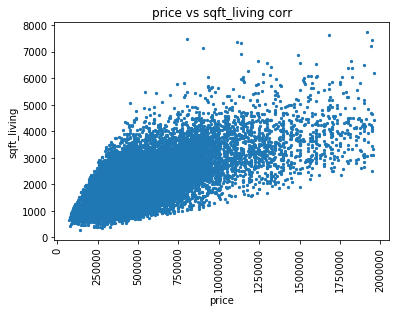

<Figure size 1080x1080 with 0 Axes>

In [48]:
# Set marker size to 5
plt.scatter(housedata['price'], housedata['sqft_living'], s=5)
plt.title('price vs sqft_living corr')
plt.ylabel('sqft_living')
plt.xlabel('price')
plt.xticks(rotation='vertical')
plt.figure(figsize = (15,15))
plt.show()

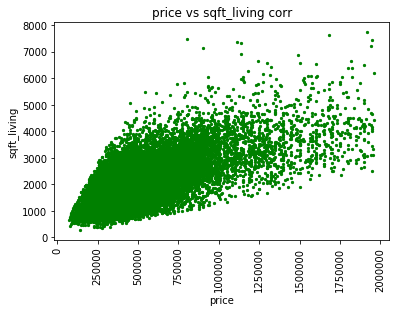

<Figure size 1080x1080 with 0 Axes>

In [49]:
# Change points color
plt.scatter(housedata['price'], housedata['sqft_living'], s=5, c='g')
plt.title('price vs sqft_living corr')
plt.ylabel('sqft_living')
plt.xlabel('price')
plt.xticks(rotation='vertical')
plt.figure(figsize = (15,15))
plt.show()


### 11. More on color

You remebered that there were a `grade` feature also highly correlated with `price`, but unfortunatly 
qualitive. But you have heard somewere that you could set points color using qualitive feature:
```
color = [1,1,1,0,0,0]
x = [0,1,2,3,4,5]
y = [0,1,2,3,4,5]
plt.scatter(x,y,c=color)
```

Unfortunatly `grade` has to much variability create a new column that takes values:

- 1 if grade 1-3
- 2 if grade 4-7
- 3 if grade 8-10
- 4 if grade 11-13

and use it as color for previous scatter plot:

- Make a rough version of data.grade
- Plot a scatter plot with points colored according to your new column
- Use cmap option, of a plt.scatter()
- Explain what does cmap option controls
- Elaborate on the resulting picture

**Hint** check out pandas `map` or pandas `apply` function

**cmaps** https://matplotlib.org/3.1.0/tutorials/colors/colormaps.html

In [51]:
# Create rough version of grade
def gradate(x):
    if x >=1 and x <=3:
        return 1
    elif x >=4 and x <=7:
        return 2
    elif x >=8 and x <=10:
        return 3
    elif x >=11 and x <=13:
        return 4
housedata['_grade'] = housedata['grade'].apply(gradate)

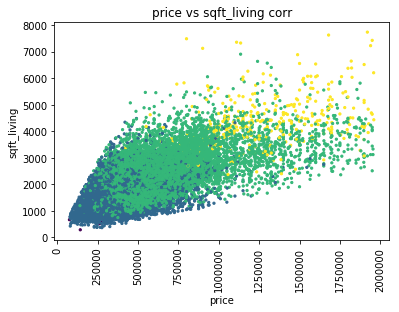

<Figure size 1080x1080 with 0 Axes>

In [52]:
# Change points color according to a rough grade
plt.scatter(housedata['price'], housedata['sqft_living'], s=5, c=housedata['_grade'])
plt.title('price vs sqft_living corr')
plt.ylabel('sqft_living')
plt.xlabel('price')
plt.xticks(rotation='vertical')
plt.figure(figsize = (15,15))
plt.show()

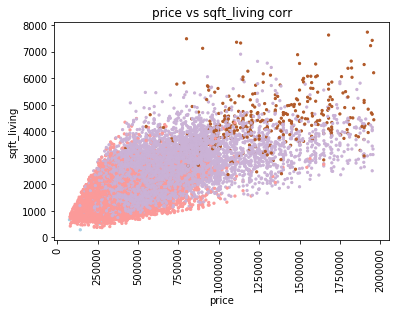

<Figure size 1080x1080 with 0 Axes>

In [53]:
# Change cmap to Paired
plt.scatter(housedata['price'], housedata['sqft_living'], s=5, c=housedata['_grade'], cmap="Paired")
plt.title('price vs sqft_living corr')
plt.ylabel('sqft_living')
plt.xlabel('price')
plt.xticks(rotation='vertical')
plt.figure(figsize = (15,15))
plt.show()

# Seaborn

Seaborn is a wrap around matplotlib, along with pandas it allows you to build cleaner plots
much easier. 

But in the end it is just a wrap, if you want flexibility you need to go back to matplotlib.

Check their example gallery https://seaborn.pydata.org/examples/index.html it is awesome!

In [54]:
import seaborn as sns

### 12. Box plot

Lets switch to something else, number of bathroom sounds important to a price.
We could plot a boxplot of prices for every unique value of bathrooms.

And with `seaborn` we could do it in 1 single line!

- Plot a boxplot of prices for every unique value of bathrooms using seaborn.boxplot
- Increase figure size to make picture looks better
- Elaborate on the resulting picture

**Hint** check out seaborn documentation on boxplots https://seaborn.pydata.org/examples/grouped_boxplot.html

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26]),
 <a list of 27 Text xticklabel objects>)

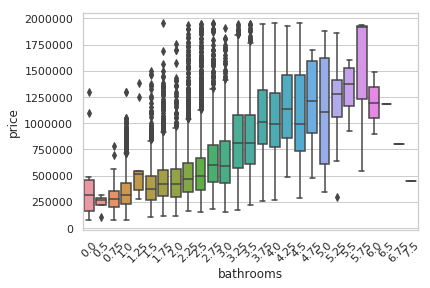

In [55]:
# Plot boxplots
sns.set(style="whitegrid")
ax = sns.boxplot(x=housedata["bathrooms"], y=housedata["price"])
plt.xticks(rotation=45)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26]),
 <a list of 27 Text xticklabel objects>)

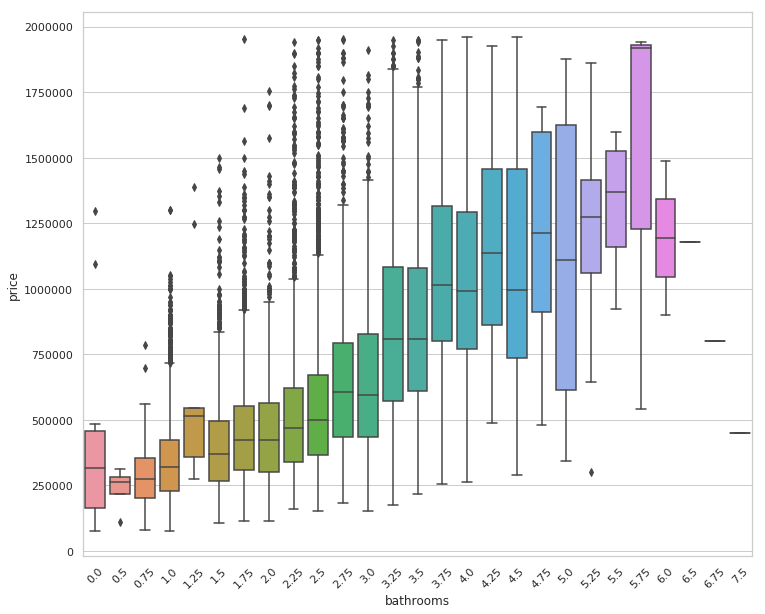

In [56]:
# Increase figure size
sns.set(style="whitegrid", rc={'figure.figsize':(12,10)})
ax = sns.boxplot(x=housedata["bathrooms"], y=housedata["price"])
plt.xticks(rotation=45)

### 13. Bar chart

Waterfront is a rare feature, does it strongly affect price?

To answer this question you decided to plot `bar chart` of
price of houses with and without `waterfront`:

- Count number of houses **with** waterfront
- Plot seaborn categorical plot. Use this example https://seaborn.pydata.org/examples/grouped_barplot.html as a guide.
- Elaborate on the resulting picture.


In [57]:
# Count number houses with waterfront
housedata[housedata['waterfront'] != 0].shape[0]

114

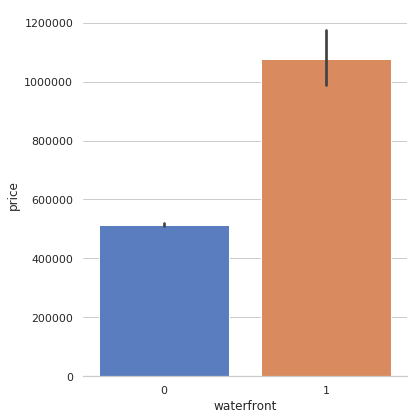

In [58]:
# plot the picture
sns.set(style="whitegrid")
g = sns.catplot(x='waterfront', y='price', data=housedata,
                height=6, kind="bar", palette="muted")
g.despine(left=True)
g.set_ylabels("price")

### 14 Line plot

Remember your last time renting an apartments? When does it happen, summer? winter? Season could strongly affect

house prices. Lets check this out.

- Plot a line chart: price dependency on month
- Fix figure sizes if needed
- Fix xticks (set the to be `1..12`)
- Fix xticklabels to be actual month's names and not numbers (remember to rotate them) 
- When does the prices goes up?
- What is the best month to buy a house? (atleast in terms of general trend)
- Does this trend depend on view feature? Plot multiple lines on a single plot.
- Elaborate on the result


**Hint 1** sns.lineplot (aside from a plot) return you an Axes object, which has many different parameters and methods, e.g.:

```
ax = sns.lineplot(x="timepoint", y="signal", hue="region", style="event", data=fmri)
ax.set_xticks(list(range(0, 20)))
```

Color pallete https://seaborn.pydata.org/tutorial/color_palettes.html

Line plot docs https://seaborn.pydata.org/generated/seaborn.lineplot.html

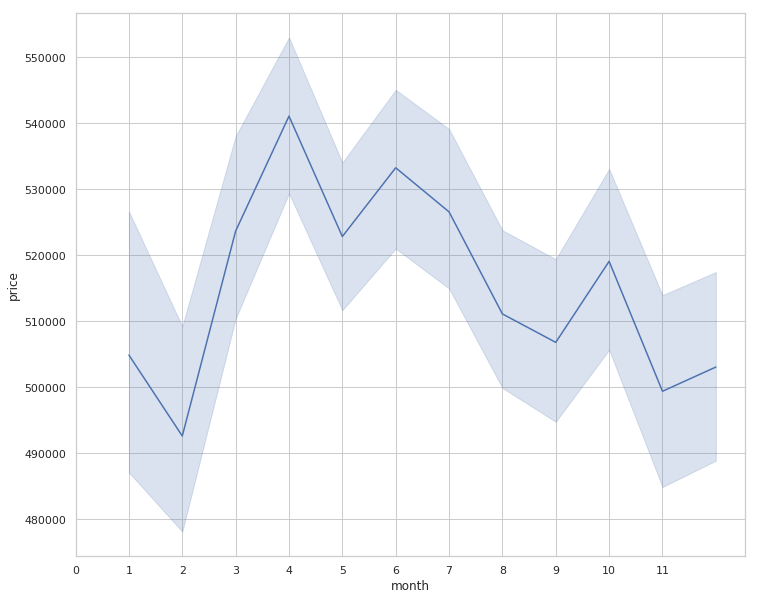

In [59]:
# Plot a line chart
sns.set(style="whitegrid")
ax = sns.lineplot(x="month", y="price", data=housedata)
ax.set_xticks(list(range(0, 12)))

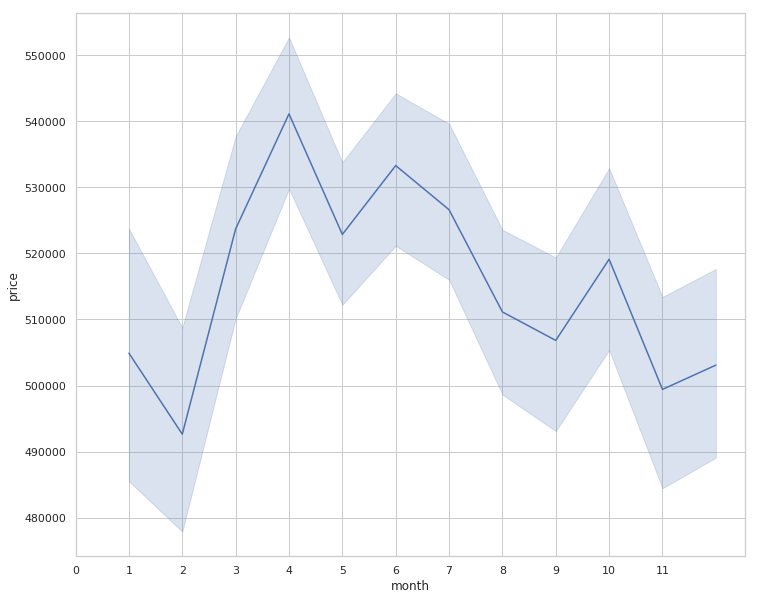

In [60]:
# Fix figure size
sns.set(style="whitegrid")
sns.set(style="whitegrid", rc={'figure.figsize':(12,10)})
ax = sns.lineplot(x="month", y="price", data=housedata)
ax.set_xticks(list(range(0, 12)))

In [61]:
list(housedata.date_.dt.month_name().unique())

['October',
 'December',
 'February',
 'May',
 'June',
 'January',
 'April',
 'March',
 'July',
 'November',
 'August',
 'September']

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11]),
 <a list of 12 Text xticklabel objects>)

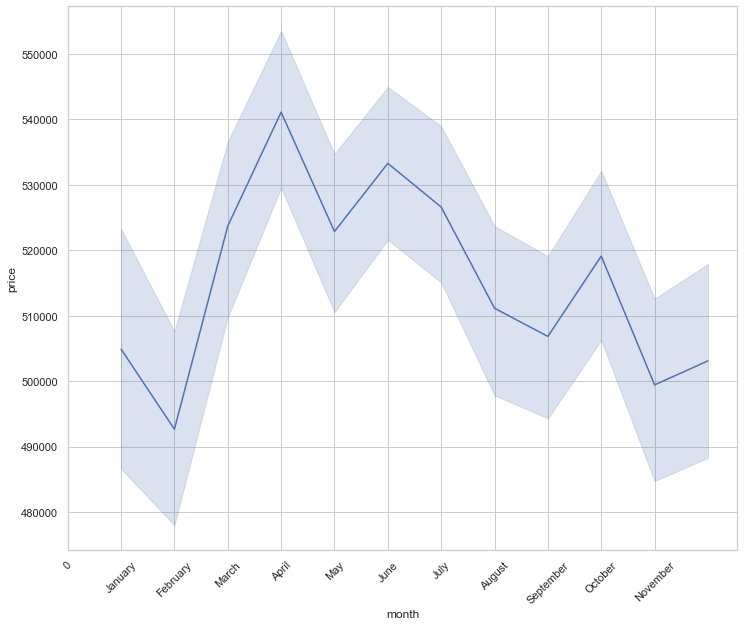

In [138]:
# Fix xticks
# Fix xticks labels
sns.set(style="whitegrid")
# sns.set(style="whitegrid", rc={'figure.figsize':(12,10)})
ax = sns.lineplot(x="month", y="price", data=housedata)
# ax.set(xticklabels =housedata.date_.dt.month_name().unique())
ax.set_xticks(list(range(0, 12)))
monthlabel = [0, 'January',
'February',
'March',
'April',
'May', 
'June',
'July',
'August',
'September',
'October',
'November',
'December']
ax.set(xticklabels=monthlabel)
plt.xticks(rotation=45)

In [ ]:
# When does the prices goes up?
# In spring

In [ ]:
# What is the best month to buy a house?
# February

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11]),
 <a list of 12 Text xticklabel objects>)

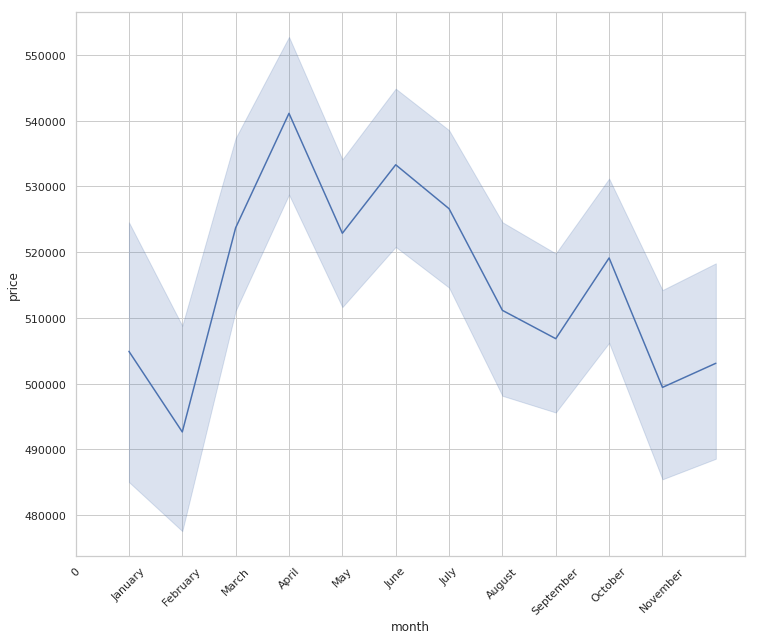

In [62]:
# Plot multiple lines on a single plot (view feature)
# Fix xticks
# Fix xticks labels
sns.set(style="whitegrid")
# sns.set(style="whitegrid", rc={'figure.figsize':(12,10)})
ax = sns.lineplot(x="month", y="price", data=housedata)

# ax.set(xticklabels =housedata.date_.dt.month_name().unique())
ax.set_xticks(list(range(0, 12)))
monthlabel = [0, 'January',
'February',
'March',
'April',
'May', 
'June',
'July',
'August',
'September',
'October',
'November',
'December']
ax.set(xticklabels=monthlabel)
plt.xticks(rotation=45)

# Say no more, Machine Learning!

### 16. Prepare data from training machine learning models.
For this task we will try to predict the house price, so our target feature is `price`.

- Separate features and target.
- Split the data into train (`80%` of the data) and test (`20%` of the data). 
- Use random_state parameter = $42$.
- What does fixing random_state do?

**Hint 1** Most of the train-testing routines are in the `sklearn` submodule `model_selection`

In [12]:
housedata = housedata.drop(['date_','year','month', 'Day', 'weekday'], axis=1 )

In [13]:
# Separate features and the target (price)
y = housedata['price'].values
print(y)
X = housedata.loc[:, housedata.columns != 'price'].values
X

[221900. 538000. 180000. ... 402101. 400000. 325000.]


array([[ 7.12930052e+09,  3.00000000e+00,  1.00000000e+00, ...,
        -1.22257000e+02,  1.34000000e+03,  5.65000000e+03],
       [ 6.41410019e+09,  3.00000000e+00,  2.25000000e+00, ...,
        -1.22319000e+02,  1.69000000e+03,  7.63900000e+03],
       [ 5.63150040e+09,  2.00000000e+00,  1.00000000e+00, ...,
        -1.22233000e+02,  2.72000000e+03,  8.06200000e+03],
       ...,
       [ 1.52330014e+09,  2.00000000e+00,  7.50000000e-01, ...,
        -1.22299000e+02,  1.02000000e+03,  2.00700000e+03],
       [ 2.91310100e+08,  3.00000000e+00,  2.50000000e+00, ...,
        -1.22069000e+02,  1.41000000e+03,  1.28700000e+03],
       [ 1.52330016e+09,  2.00000000e+00,  7.50000000e-01, ...,
        -1.22299000e+02,  1.02000000e+03,  1.35700000e+03]])

In [14]:
# import train_test_split from sklearn model_selection submodule,
# split the data into train and test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
print(X_train, X_test, y_train, y_test)

[[ 1.83698016e+09  4.00000000e+00  2.50000000e+00 ... -1.22125000e+02
   2.92000000e+03  4.50000000e+03]
 [ 9.22140034e+09  4.00000000e+00  1.75000000e+00 ... -1.22320000e+02
   1.27000000e+03  3.27000000e+03]
 [ 6.66902049e+09  4.00000000e+00  2.25000000e+00 ... -1.22284000e+02
   2.17000000e+03  8.40000000e+03]
 ...
 [ 7.20235048e+09  3.00000000e+00  2.50000000e+00 ... -1.22032000e+02
   1.69000000e+03  2.65000000e+03]
 [ 1.72304903e+09  1.00000000e+00  7.50000000e-01 ... -1.22323000e+02
   1.17000000e+03  1.50000000e+04]
 [ 6.14765028e+09  4.00000000e+00  2.50000000e+00 ... -1.22099000e+02
   3.02000000e+03  5.99700000e+03]] [[ 2.59182031e+09  4.00000000e+00  2.25000000e+00 ... -1.22162000e+02
   2.39000000e+03  7.70000000e+03]
 [ 7.97420082e+09  5.00000000e+00  3.00000000e+00 ... -1.22285000e+02
   2.37000000e+03  6.28300000e+03]
 [ 7.70145011e+09  4.00000000e+00  2.50000000e+00 ... -1.22129000e+02
   3.71000000e+03  9.68500000e+03]
 ...
 [ 6.15020000e+09  3.00000000e+00  1.0000000

In [ ]:
# What does fixing random_state do?
# Allow to generate same random values from the same random seed

### 17. Train your first model.

Since this is a regression task you decided that the Linear Regression will do the job:

- Create a Linear Regression class. Leave all parameters by default.
- Fit the model with the **training data**.
- Predict house prices of the **test data** (which were not seen by the model).
- Predict house prices of the **train data**.
- Report model perfomance in terms of `Mean Squared Error` on **train** and **test data.**
- Elaborate on the result.

**Hint 1** Check out `sklearn.metrics` module.

In [15]:
# make all imports
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn import linear_model
from sklearn.metrics import mean_squared_error

In [40]:
# Create a linear model
# load LinearRegression from sklearn.linear_models
model = linear_model.LinearRegression()

In [41]:
# Train the linear model
# model.fit(...)
model.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [42]:
# Make predictions on train and test data
# model.predict(...)
y_pred_train=model.predict(X_train)
y_pred_test=model.predict(X_test)

In [43]:
# Report MSE of both train and test predictions
print(mean_squared_error(y_train, y_pred_train))
print(mean_squared_error(y_test, y_pred_test))

39776461159.22379
44075087866.14515


### 18. Standardize your data.

You remebered that either Max or Mikhail told you, that for building a linear model **data normalization** is essential. But you completely forgot about it. Lets fix this.


> Standardization is a linear transformation that is applied to each feature independently.
First, mean $\hat{\mu_i}$ and variance $\hat{\sigma_i}$ of the $i$-th feature are estimated, after that we subtract the mean from every value and divide the result by variance:

$$\frac{x_{ij}-\hat{\mu_i}}{\hat{\sigma_i}}$$

>After that, each feature will have zero mean and variance of 1. This operation needs to be performed on the train data first, and then the same means and variances are to be used to modify the test set. This way we will note introduce any _leaks_ of information about the data in our test set.

Your goal is to Normalize (or Standartize) your data:

- Standartize your **train** data.
- Apply transformation to your **test** data.
- Fit the model again (using training data).
- Predict the housing prices on the **train** and **test data**.
- Does the scaling improve preformance?

**Hint** `sklearn.preprocessing` has multiple standartizing options, for this task you are suppose to use  `StandardScaler` preprocessing transformation.

https://scikit-learn.org/stable/modules/classes.html#module-sklearn.preprocessing


In [20]:
# import a scaler
from sklearn.preprocessing import StandardScaler

In [84]:
# Standartize your train data
# scaler.fit(...)
# scaler.transform(...)
# alternatively .fit_transform(...)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
print(scaler.fit_transform(X_train))

[[-0.95364302  0.67921258  0.50673542 ...  0.63788882  1.37181296
  -0.30480438]
 [ 1.61677422  0.67921258 -0.4723706  ... -0.75582327 -1.04165447
  -0.34984593]
 [ 0.72832516  0.67921258  0.18036675 ... -0.49852257  0.27478231
  -0.16198969]
 ...
 [ 0.91397015 -0.39163018  0.50673542 ...  1.30258228 -0.42731731
  -0.37254981]
 [-0.99330091 -2.53331571 -1.77784531 ... -0.77726499 -1.18792522
   0.07969671]
 [ 0.54684321  0.67921258  0.50673542 ...  0.8237171   1.51808371
  -0.24998551]]


In [85]:
# Apply same transform on your test data
X_test_scaled = scaler.fit_transform(X_test, y_test)

In [86]:
# Fit the Linear model again on scaled data
model_scaled = linear_model.LinearRegression()
model_scaled.fit(X_train_scaled, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [87]:
# Make predictions
y_pred_train=model_scaled.predict(X_train_scaled)
y_pred_test=model_scaled.predict(X_test_scaled)

In [88]:
# Elaborate on the result
# Score doesnt change but proubably it shouldnt
print(mean_squared_error(y_train, y_pred_train))
print(mean_squared_error(y_test, y_pred_test))

39776461159.22381
44287918951.53779


### 19. Diffent types of models and scaling.

Along with simple Linear Regression (Least Squares), you have seen two additional algorithms that fit a linear refression model to the data:
- Ridge Regression `sklearn.linear_models.Ridge`
- Lasso Regression `sklearn.linear_models.Lasso`

Lets see how they react to the scaling of the data.

- Fit Ridge and Lasso models on normalized data
- Compare their perfomances

To make your life easier you are suggested to write 2 functions:
 - `report_mse`
 - `evaluate_model`

You will find their description below.


**Hint** for the `evaluate_model` you just need to put appropriate steps from **tasks 17, 18** inside a function.

Use parameter $\alpha=10^4$.

In [26]:
def report_mse(model, X, y):
    """
    Reports MSE of the model on given data
    ---
    
    Parameters
    ---
    
    model - trained sklearn model
    
    X - array,
     (n_observations, n_features) matrix,
     used to predict target
    
    y - array,
     (n_observation, ) array of true target
     
    Returns
    ---
    
    mse - mean squared error
     between true target and predicted target
    """
    
    # Your code here
    return mean_squared_error(model.predict(X), y)

In [28]:
def evaluate_model(model, X_train, y_train, X_test, y_test, scale=False):
    """
    Trains model on train and reports its perfomance
    on train and test data.
    ---
    
    Parameters
    ---
    
    model - sklearn regression model (not trained)
    
    X_train  - array,
     (n_observations_train, n_features) matrix,
     train data.
     
    y_train - array,
     (n_observation_train, ) array of train target
     
    X_test  - array,
     (n_observations_test, n_features) matrix,
     train data.
     
    y_test - array,
     (n_observation_test, ) array of test target
     
    scale - bool,
     whether to scale the data before training,
     default False
     
    
    Returns
    ---
    
    mse_train - float,
     mean squared error of the train prediction
     
    mse_test - float,
     mean squared error of the test prediction
    """
    
    # Your code here
    if scale == True:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train, y_train)
        X_test = scaler.fit_transform(X_test, y_test)
    model.fit(X_train, y_train)
    return report_mse(model, X_train, y_train), report_mse(model, X_test, y_test)

In [29]:
# make imports
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso


In [37]:
# fit Ridge regression model on scaled data
model = Ridge(alpha=10000)
mse_train_R, mse_test_R = evaluate_model(model, X_train, y_train, X_test, y_test, scale=True)
print(mse_train_R)
print(mse_test_R)

45129919756.22208
51233464333.43694


In [38]:
# fit Lasso regression model on original data
model = Lasso(alpha=10000)
mse_train_L, mse_test_L = evaluate_model(model, X_train, y_train, X_test, y_test, scale=True)
print(mse_train_L)
print(mse_test_L)

41035803925.51955
46499851019.194916


In [39]:
# Compare results
print(mse_test_R - mse_test_L)

4733613314.242027


### 20. Analizing trained models.

You decided to look inside your regressor and try to interpret the obtained coefficients. It is not always easy with machine learning models, but linear models provide easy explanations: the bigger the coefficient before a feature the bigger the importance of this feature for the prediction.

> Coefficients of the linear model are easily interpretable:
$$
y = \theta_1 x + \theta_0
$$
> Increasing $x$ by $1$, will increase $y$ by $\theta_1$


- Examine coefficients of the trained Linear Regression model on normalized data. Plot a horizontal bar chart of feature importance. Customize a plot appropriatly.
- What are the three largest coefficients by absolute value? What features do they correspond to?



**Hint 1** use `.coef_` attribute of the trained model to access the raw coefficients values.

**Hint 2** use `plt.barh`:

```
plt.barh(X.columns, model.coef_)
```

<BarContainer object of 18 artists>

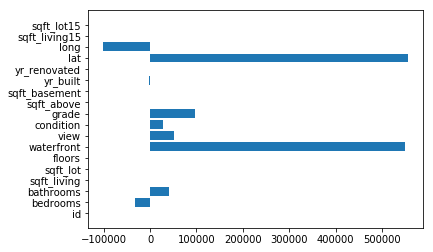

In [57]:
# You should already have trained linear model on unnormalized
# Plot a bar chart of feature importances
sorted(model.coef_, reverse = True)
plt.barh(housedata.drop(columns = 'price').columns, model.coef_)

In [81]:
ind = np.argsort(model.coef_)[::-1][:3]
for i in ind:
    print(housedata.drop(columns = 'price').columns[i], model.coef_[i])

lat 555566.4657841561
waterfront 550244.1337832808
grade 96099.55182756373


In [82]:
# print 3 largest coefficients by magnitude
# You might want to write a function for it
# to use it in the future

def max_coef(model, names, k=3):
    """
    Return k biggest coefficients of a linear model
    ---
    
    Parameters
    ---
    
    model - trained linear model
    
    names - array-like,
     list of feature names
     
    k - int,
     number of features to return
     
    Returns
    ---
    
    top_k_features - dict,
     key - feature name
     value - corresponding coefficient magnitude
    """
    # Your code goes here
    # Hint: use np.argsort, check the returned order!
    ind = np.argsort(model.coef_)[::-1][:k]
    for i in ind:
        print(names[i], model.coef_[i])
        
        
max_coef(model, housedata.drop(columns = 'price').columns, k=3)


lat 555566.4657841561
waterfront 550244.1337832808
grade 96099.55182756373


<BarContainer object of 18 artists>

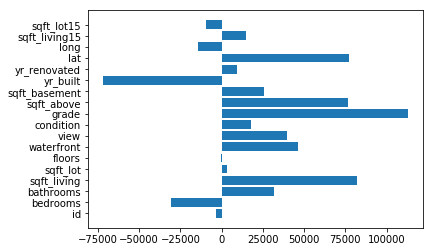

In [90]:
# You should already have trained linear model on normalized data
# Plot a bar chart of feature importances
sorted(model_scaled.coef_, reverse = True)
plt.barh(housedata.drop(columns = 'price').columns, model_scaled.coef_)

In [91]:
# print 3 largest coefficients by magnitude
max_coef(model_scaled, housedata.drop(columns = 'price').columns, k=3)

grade 112774.888750989
sqft_living 82009.89020235332
lat 76979.24142880147


In [ ]:
# Compare the results
# ?

### 21. Explore effects of regularization on the coefficients.

Your goal is to compare how Ridge and Lasso affects model coefficients. 


- Fit **Ridge Regression** and **Lasso models** on the **scaled train data**, using parameter $\alpha = 10^4$.
- What does parameter $\alpha$ stands for? (in **Lasso** and **Ridge**) 
- Report three largest coefficients (by absolute value) for each model.
- What features do they correspond to? 
- Are they different from what we got from the simple **Linear Regression** earlier?
    - Compare coeficients magnitude (plot a bar plot)
    
- How many non-zero coefficients are there in the trained **Lasso** and **Ridge** models?

**Hint 1** use `np.nonzero()` function

**Hint 2** You could plot barh using pandas interface https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.plot.barh.html

In [98]:
# Fit the models
model_ridge = Ridge(alpha=10000)
mse_train_R, mse_test_R = evaluate_model(model_ridge, X_train, y_train, X_test, y_test, scale=True)
model_lasso = Lasso(alpha=10000)
mse_train_L, mse_test_L = evaluate_model(model_lasso, X_train, y_train, X_test, y_test, scale=True)

In [ ]:
# Explain alpha parameter

# alpha stand for regularization - 
# less value stand for less regularization
# regularisation keeps our coefs such as 
# their sum minimized (lasso) 
# or even completly vanishes (ridge)

In [99]:
# Report  three largest coefficients of the Ridge
max_coef(model_ridge, housedata.drop(columns = 'price').columns, k=1)

grade 64566.71613525426


In [101]:
# Report  three largest coefficients of the Lasso
max_coef(model_lasso, housedata.drop(columns = 'price').columns, k=1)

sqft_living 143376.34587964497


In [102]:
# Compare the results between them and with 
# vanilla Linear Regression results trained earlier
print(mse_test_R)
print(mse_test_L)
print(mse_test)

44287918951.53779
46499851019.194916
46499851019.194916


In [107]:
# How many non-zero coefficients are there in the trained Lasso and Ridge models?
print(np.count_nonzero(model_ridge.coef_))
print(np.count_nonzero(model_lasso.coef_))

18
13


### 22. Try a diffent type of model.

Linear is not the only regression model, you could succesfully solve regression problems using our old friend K nearest neighbours.

- Import K Nearest Neoghbors regression model. `sklearn.neighbors.KNeighborsRegressor`
- Fit it with train data. Use $k=7$ number of neighbors for your model.
- Report model perfomance on train and test data, which is better, why?
- Do you need to normalize the data for KNN model?
- Elaborate on the result.


**Hint** https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsRegressor.html

In [108]:
# make imports
from sklearn.neighbors import KNeighborsRegressor

In [120]:
# train the model
knn = KNeighborsRegressor(n_neighbors=4, metric='euclidean', n_jobs=-1)
# knn.fit(X_train, y_train)
knn_mse_train, knn_mse_test = evaluate_model(knn, X_train, y_train, X_test, y_test, scale=False)

In [121]:
# Report KNN perfomance
print(knn.score(X_test, y_test))

0.3438030904169673


In [ ]:
# Have you used normalized or unnormalized data, why?
# unnormalized because we want to keep dispersion

In [122]:
# Elaborate on the result, how it is compare to linear models?
print(mse_test_R)
print(mse_test_L)
print(mse_test)
print(knn_mse_test)

# worser on test

44287918951.53779
46499851019.194916
46499851019.194916
94732871880.55984
